# Blend Modes


Blend Modes - в редактировании цифровых изображений и компьютерной графике используются для определения того, как два изображениясмешиваются друг с другом. Режим смешивания по умолчанию в большинстве приложений просто скрывает нижний уровень, перекрывая его тем, что присутствует в верхнем (см. Альфа-композитинг). Однако, поскольку каждый пиксель имеет числовое представление, существует большое количество способов смешивания двух слоев.

Большинство программ редактирования графики, таких как Luminar, Photoshop, GIMP, позволяют пользователю изменять основные режимы наложения, например, применяя различные уровни непрозрачности верхнего слоя. Верхний слой не обязательно является слоем в приложении; это может быть применено к живописи или инструментам редактирования. Верхний «слой» также может называться «смешанным слоем» или «активным слоем».

Задают алгоритмы по которым смешиваются цвета исходного и накладываемого изображений для получения результирующего.


Links:

* [Blending Modes of Photoshop & Co.](http://www.simplefilter.de/en/basics/mixmods.html)
* [Porter/Duff Compositing and Blend Modes](http://ssp.impulsetrain.com/porterduff.html)
* [Blend modes](https://en.wikipedia.org/wiki/Blend_modes)

In [ ]:
# import libraries

In [1]:
import sys
import cv2 as cv

In [2]:
from PIL import Image

In [3]:
import math

In [4]:
import numpy as np
import matplotlib.pyplot as plt 
import matplotlib.image as mpimg
%matplotlib inline

In [5]:
# read images
background = cv.imread("beach.jpg")
background = cv.cvtColor(background, cv.COLOR_BGR2RGB) / 255.0

foreground = cv.imread("pattern.png")
foreground = cv.cvtColor(foreground, cv.COLOR_BGR2RGB) / 255.0

div_error = 0.00000000000001

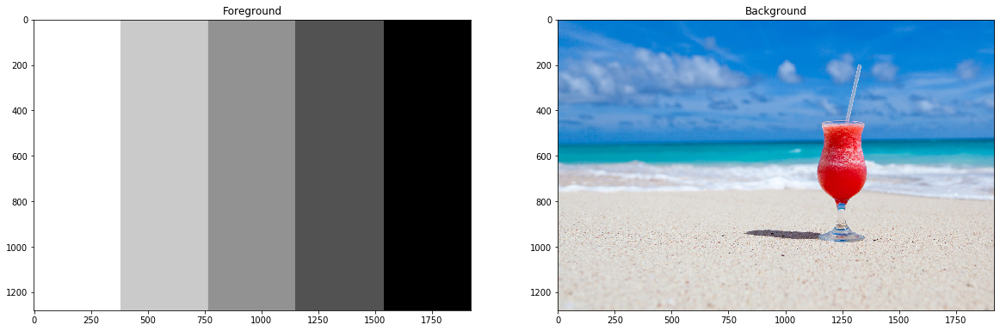

In [6]:
# plt.imshow(foreground)
# plt.title('Foreground')
# plt.show()

# plt.imshow(background)
# plt.title('Background')
# plt.show()

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
axs[0].set_title('Foreground')
axs[0].imshow(foreground)
axs[1].set_title('Background')
axs[1].imshow(background)
plt.show()

## Normal blend mode

Это стандартный режим наложения, который использует только верхний слой, без смешения его цветов со слоем под ним
$$f(a,b)=b$$ 
где 
* a - это значение цветового канала в нижележащем слое, 
* b - это значение соответствующего канала верхнего уровня. 

Результат чаще всего объединяется с нижним слоем с использованием «простого» alpha blend, но возможны и других операций [Porter-Duff](http://ssp.impulsetrain.com/porterduff.html). 
Компоновка приводит к тому, что форма верхнего слоя, определяемая его альфа-каналом, проявляется над нижним слоем.

В реальной жизни режиму Normal соответствует просмотр двух сцен через полупрозрачное зеркало. Сцена видимая на просвет — исходное изображение; сцена видимая в отражении — корректирующее изображение; коэффициент отражения зеркала — Opacity.

В фотопроцессе режиму Normal соответствует экспозиция двух сцен на один кадр при условии, что суммарная экспозиция приведена к нормальной. Первая сцена — исходное изображение; вторая сцена — корректирующее изображение; доля экспозиции второй сцены от общей — Opacity.

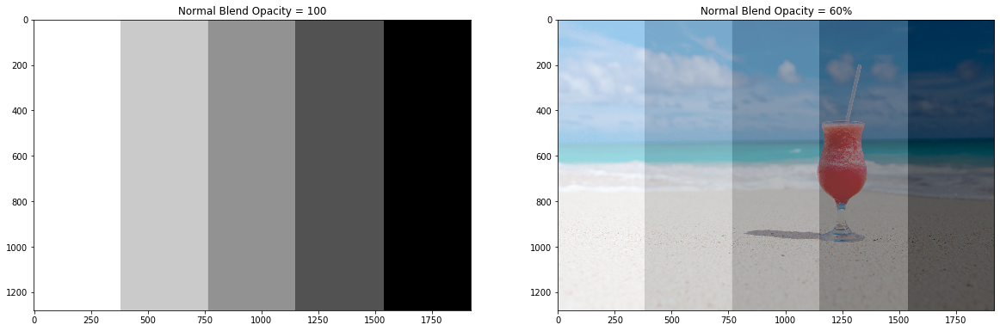

In [7]:
opacity = 1.0
blend_normal = cv.addWeighted(foreground, opacity, background, 1.0 - opacity, 0)

# plt.imshow(blend_normal)
# plt.title('Normal Blend Opacity = 100')
# plt.show()

opacity = 0.6
blend_opacity = cv.addWeighted(foreground, opacity, background, 1.0 - opacity, 0)

# plt.imshow(blend_opacity)
# plt.title('Normal Blend Opacity = 60%')
# plt.show()

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
axs[0].set_title('Normal Blend Opacity = 100')
axs[0].imshow(blend_normal)
axs[1].set_title('Normal Blend Opacity = 60%')
axs[1].imshow(blend_opacity)
plt.show()

## Dissolve

Режим dissolve принимает случайные пиксели из обоих слоев. При непрозрачности верхнего слоя больше, чем у нижнего слоя, большинство пикселей берется из верхнего слоя, тогда как при низкой непрозрачности большинство пикселей берется из нижнего слоя. В этом режиме наложения не используется сглаживание, поэтому изображения могут выглядеть зернистыми и резкими.

Adobe Photoshop генерирует псевдослучайный шаблон сглаживания шума при запуске, причем каждому положению пикселя в двумерном растровом массиве назначается значение серого (R = G = B) и значение альфа 1 («включено»). Поскольку непрозрачность верхнего слоя уменьшается, значение альфа-канала некоторых из серых пикселей переключается с 1 на 0 («выключено»), в результате чего пиксели изображения, соответствующие серому пикселю в растровом массиве, либо включен (видимый, непрозрачный) или выключен (невидимый, прозрачный), без градации непрозрачности.

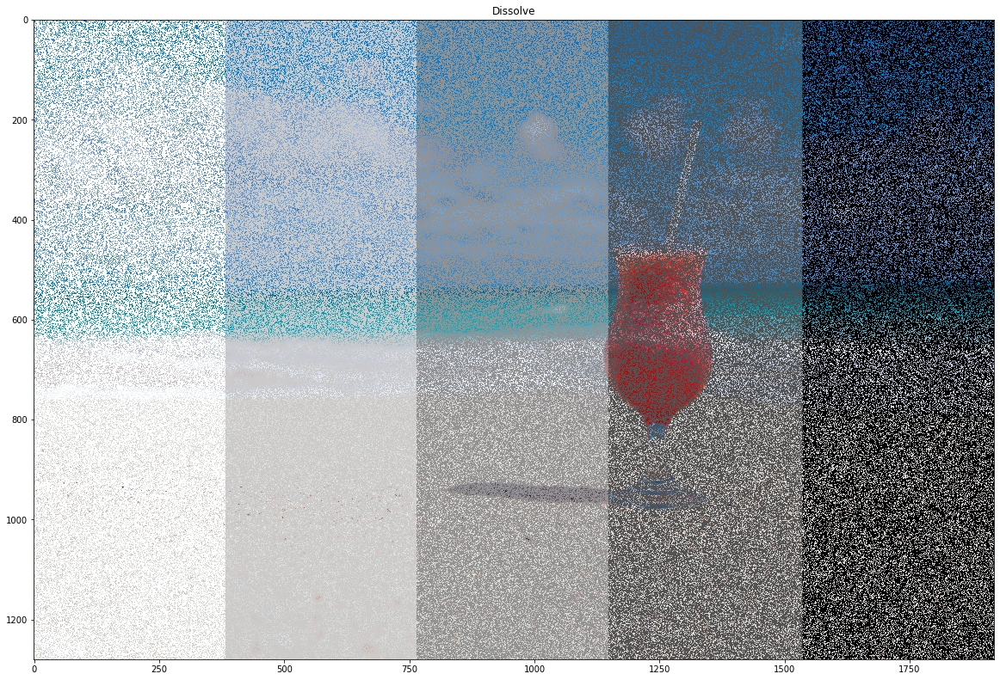

In [9]:
# Dissolve
noice = np.random.choice([0, 1], size=foreground.shape[:2], p=[.3, .7])
noice = noice * 255
noice = noice.astype('uint8')
alpha = cv.cvtColor(noice, cv.COLOR_GRAY2RGB) / 255.0  

dissolve = foreground * alpha + background * (1.0 - alpha)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(dissolve,  clim=(0.0, 10))
plt.title('Dissolve')
plt.show()

## Darken

Этот режим сравнивает передние и задние пиксели (и, возможно, цветовые каналы) и переносит соответствующий более темный пиксель в выходное изображение. Фоторедакторы обычно сравнивают каждый цветовой канал по отдельности и в результате в итоговый пиксель может попасть апример в зеленый канал значение с переднего плана, а в красный с заднего плана.

В Photo-Paint сравнивает все три цветовых значения одновременно и берет пиксель, который имеет самое низкое значение, по крайней мере, в одном цветовом канале, целиком - все его три цветовых канала передаются в результирующее изображениею

Существует третий способ обработки этого режима: Picture Publisher, а также PhotoImpact рисуют не по трем отдельным значениям RGB, а по их общему значению яркости. Как и в Photo-Paint, в зависимости от результата программы берут либо передний план, либо пиксель фона. Но решение теперь немного более сбалансировано, потому что пиксели, которые являются особенно темными в одном цветном канале, не могут иметь больший вес в итоговом результате

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/abdunkeln.gif)

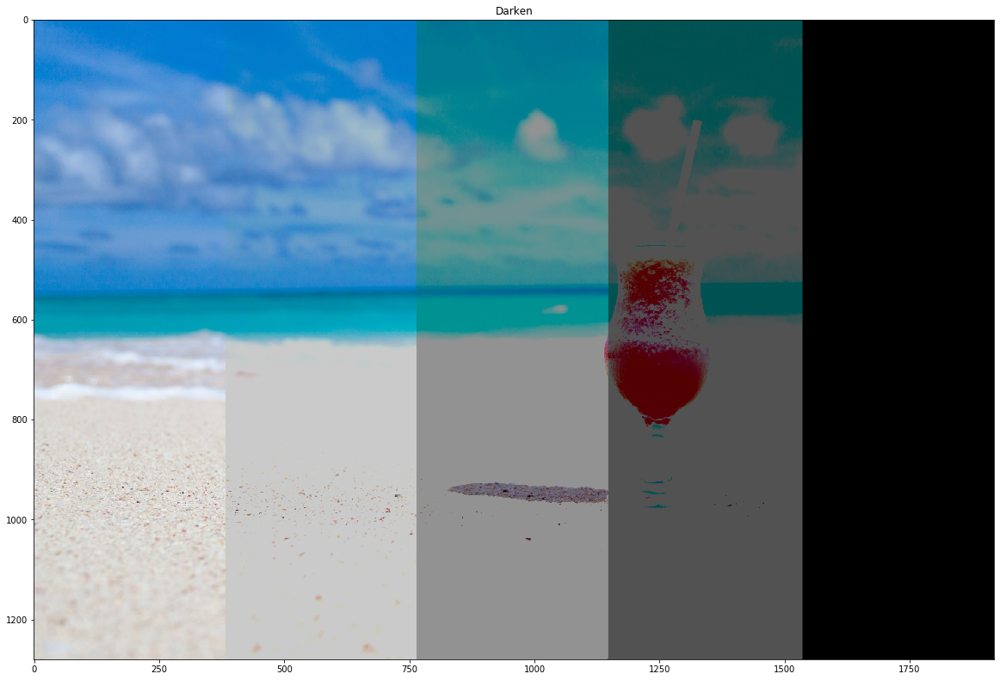

In [10]:
# Darken

mask = foreground >= background 
darken = np.zeros_like(foreground) 

darken[~mask] = foreground[~mask]
darken[mask] = background[mask] 

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(darken)
plt.title('Darken')
plt.show()

## Multiply blend

Режим умножения смешивания умножает номера каналов RGB для каждого пикселя из верхнего слоя на значения для соответствующего пикселя из нижнего слоя. Результатом всегда является более темная картина; поскольку каждое значение меньше 1, их произведение будет меньше любого из начальных значений.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/multiplizieren.gif)

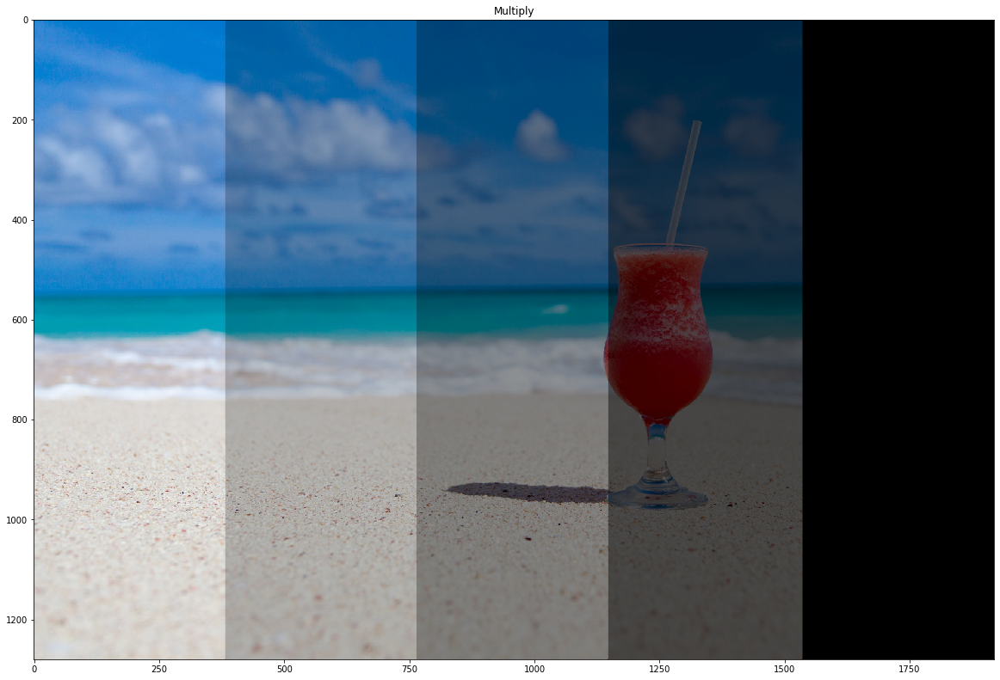

In [11]:
# Multiply blend

multiply = foreground * background

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(multiply)
plt.title('Multiply')
plt.show()

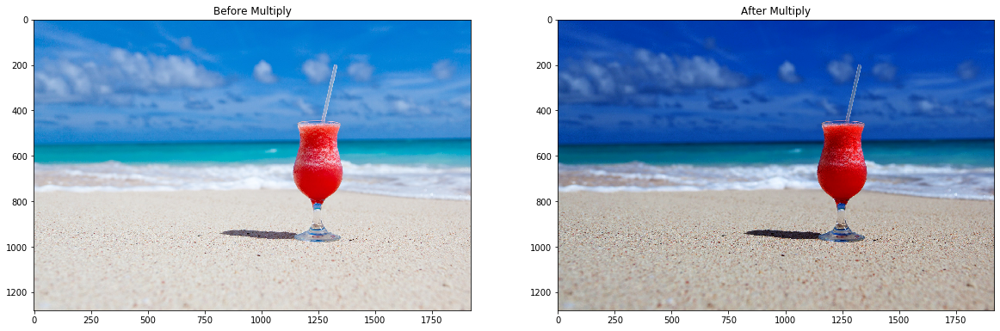

In [13]:
# Multiply blend 2

multiply = background * background

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
axs[0].set_title('Before Multiply')
axs[0].imshow(background)
axs[1].set_title('After Multiply')
axs[1].imshow(multiply)
plt.show()

## Color Burn

Режим Color Burn делит инвертированный нижний слой на верхний слой, а затем инвертирует результат. Это затемняет верхний слой, увеличивая контрастность, чтобы отразить цвет нижнего слоя. Чем темнее нижний слой, тем больше используется его цвет. Смешивание с белым не дает никакой разницы. Когда верхний слой содержит однородный цвет, этот эффект эквивалентен изменению черной точки на инвертированный цвет. 

Операция необратима из-за возможного отсечения теней. 

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/farb_nachbel.gif)

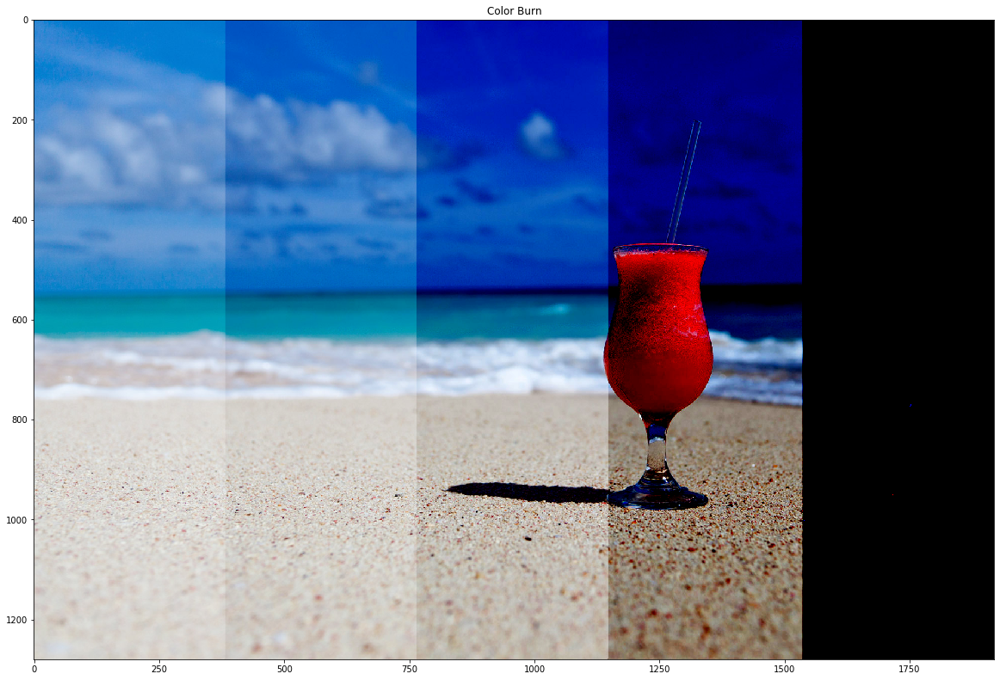

In [14]:
# Color Burn


color_burn = np.clip(1.0 - (1.0 - background) / (foreground + div_error), 0, 1.)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(color_burn)
plt.title('Color Burn')
plt.show()

## Linear Burn

Режим Linear Burn суммирует значение в двух слоях и вычитает 1. Это то же самое, что инвертировать каждый слой, складывать их вместе (как в Linear Dodge), а затем инвертировать результат.  Как результат основной цвет заменяется более темным для отражения совмещенного цвета в результате уменьшения яркости.
Смешивание с белым оставляет изображение неизменным.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/linear_nachbelichten.gif)

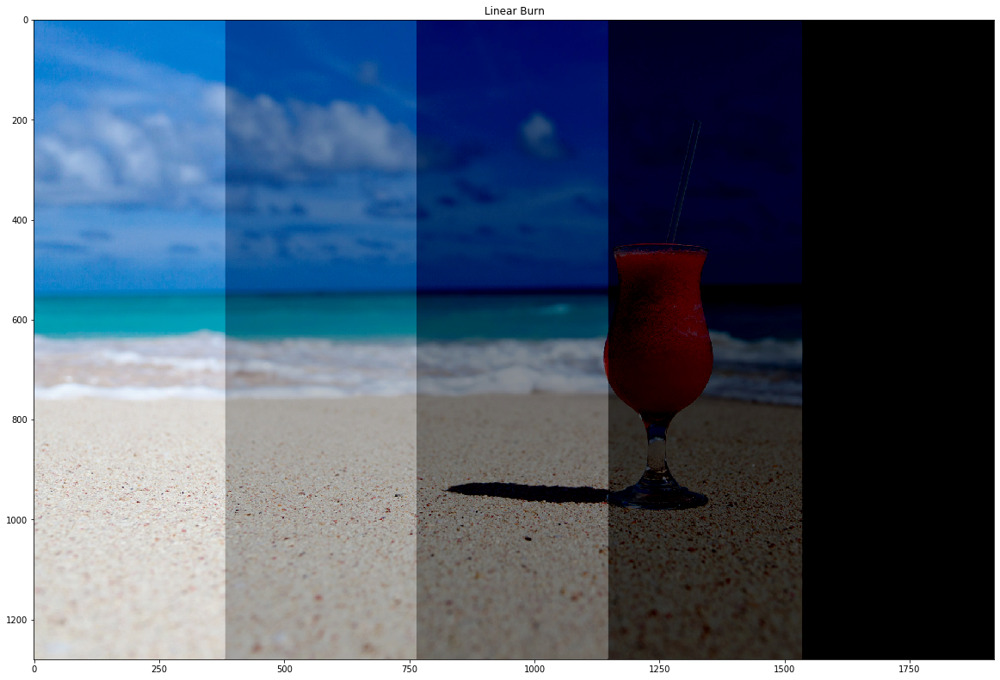

In [15]:
# Linear Burn


linear_burn = np.clip(foreground + background - 1., 0, 1.)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(linear_burn)
plt.title('Linear Burn')
plt.show()

## Lighten

Противоположность режиму Darken: соответственно в итоговое изображение переносятся более светлые пиксели. 

В этом режиме рассматривается информация цвета в каждом канале и в качестве результирующего цвета выбирается основной или совмещенный цвет в зависимости от того, какой из них светлее. Пикселы с более темным цветом по сравнению с совмещенным цветом заменяются, а пикселы с более светлым цветом по сравнению с совмещенным цветом остаются неизменными.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/aufhellen.gif)

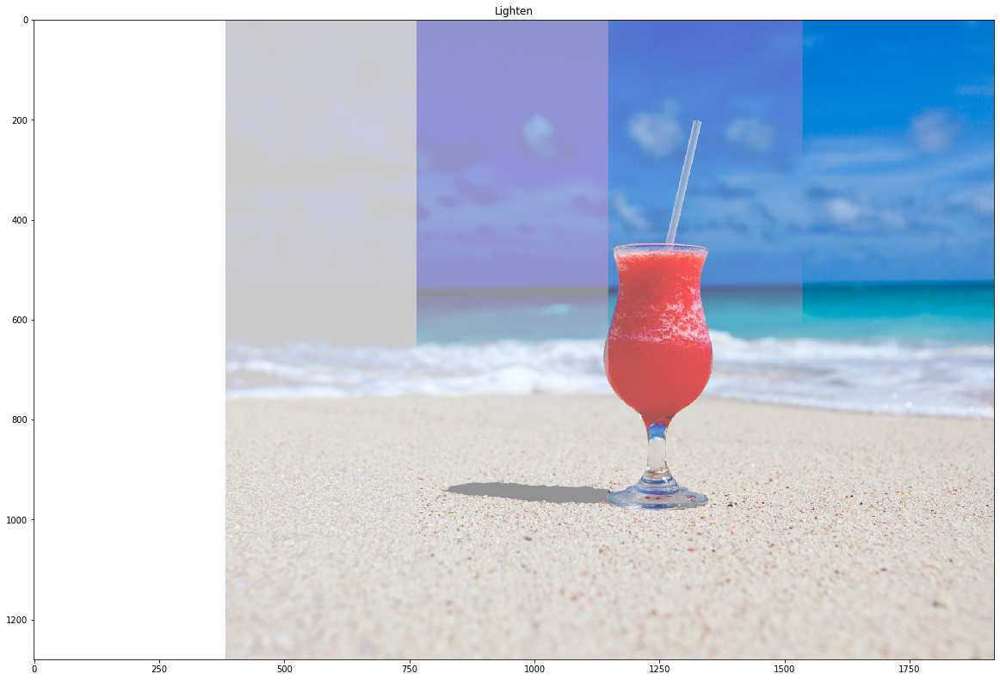

In [16]:
# Lighten

mask = foreground <= background
lighten = np.zeros_like(foreground) 

# now do the blending 
lighten[~mask] = foreground[~mask] 
lighten[mask] = background[mask]  

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(lighten)
plt.title('Lighten')
plt.show()

## Screen

В режиме смешивания Screen значения пикселей в двух слоях инвертируются, умножаются, а затем снова инвертируются. Это дает противоположный эффект для умножения и приводит к более яркой картинке.

В качестве результирующего цвета всегда применяется более светлый цвет. При осветлении с применением черного цвета цвет остается неизменным. При перекрытии с применением белого цвета цвет становится белым. Полученный эффект аналогичен наложению друг на друга изображений многочисленных фотографических слайдов с помощью проектора.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/umgek_mulipl.gif)

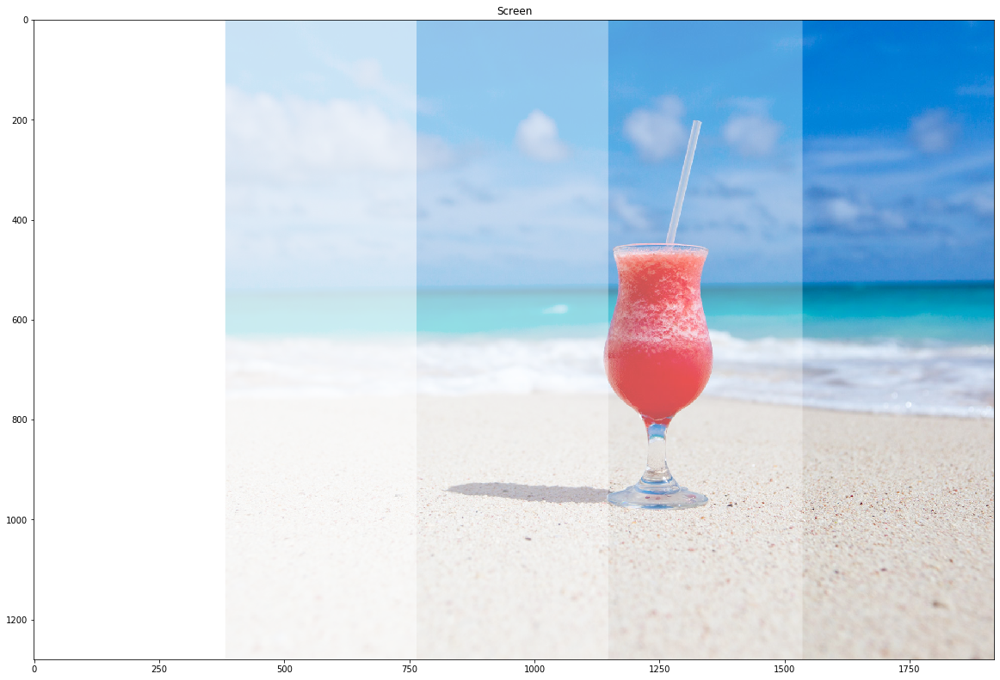

In [17]:
# Screen

screen = 1.0 - (1.0 - background) * (1.0 - foreground)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(screen)
plt.title('Screen')
plt.show()

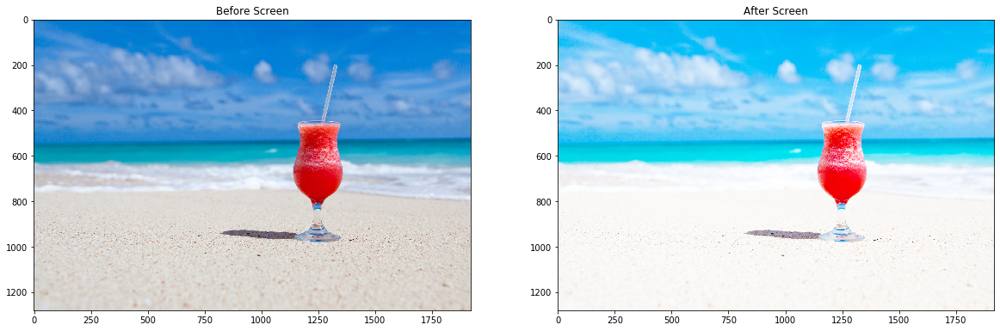

In [18]:
# Screen 2

screen = 1.0 - (1.0 - background) * (1.0 - background)

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
axs[0].set_title('Before Screen')
axs[0].imshow(background)
axs[1].set_title('After Screen')
axs[1].imshow(screen)
plt.show()

## Color Dodge

В этом режиме рассматривается информация цвета в каждом канале и основной цвет заменяется более ярким для отражения совмещенного цвета в результате уменьшения контраста между двумя цветами. 

В этом режиме нижний слой делится на инвертированный верхний слой. Это осветляет нижний слой в зависимости от значения верхнего слоя: чем ярче верхний слой, тем больше его цвет влияет на нижний слой. Смешивание любого цвета с белым дает белый. Смешивание с черным не меняет изображение. 

Операция необратима из-за возможного отсечения бликов. 

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/farb_abwedeln.gif)

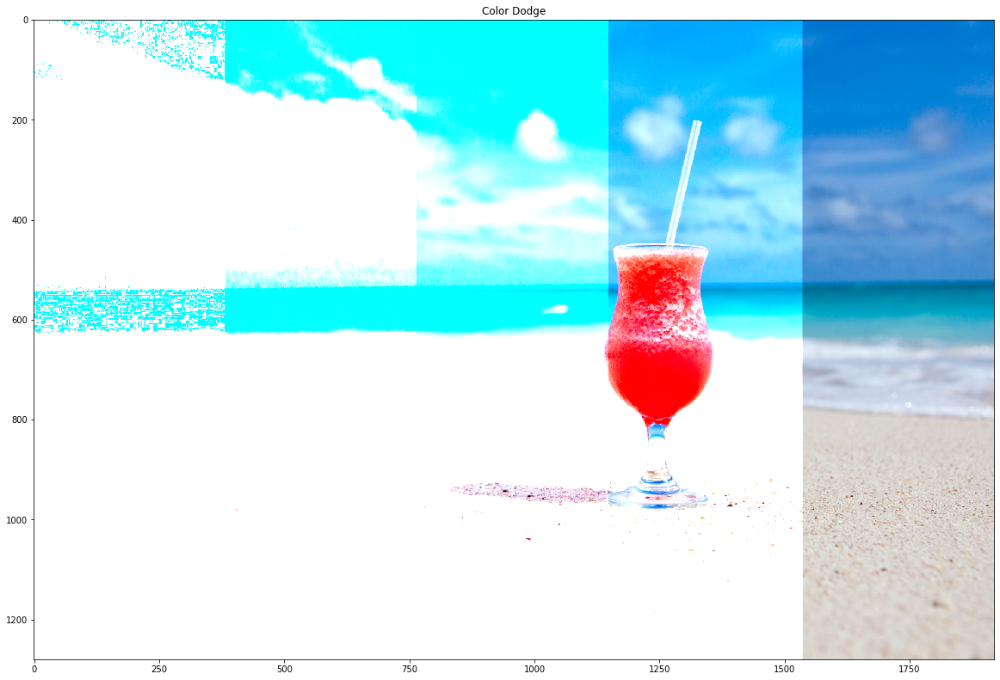

In [19]:
# Color Dodge

color_dodge = background / ((1.0 - foreground) + div_error)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(np.clip(color_dodge, 0, 1.))
plt.title('Color Dodge')
plt.show()

## Linear Dodge

В этом режиме рассматривается информация цвета в каждом канале и основной цвет преобразуется в более светлый для отражения совмещенного цвета в результате увеличения яркости. 

В этом режиме  просто суммирует значения в двух слоях (также известный как аддитивное наложение). Смешивание с белым дает белый. Смешивание с черным не меняет изображение.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/lin_abwedeln.gif)

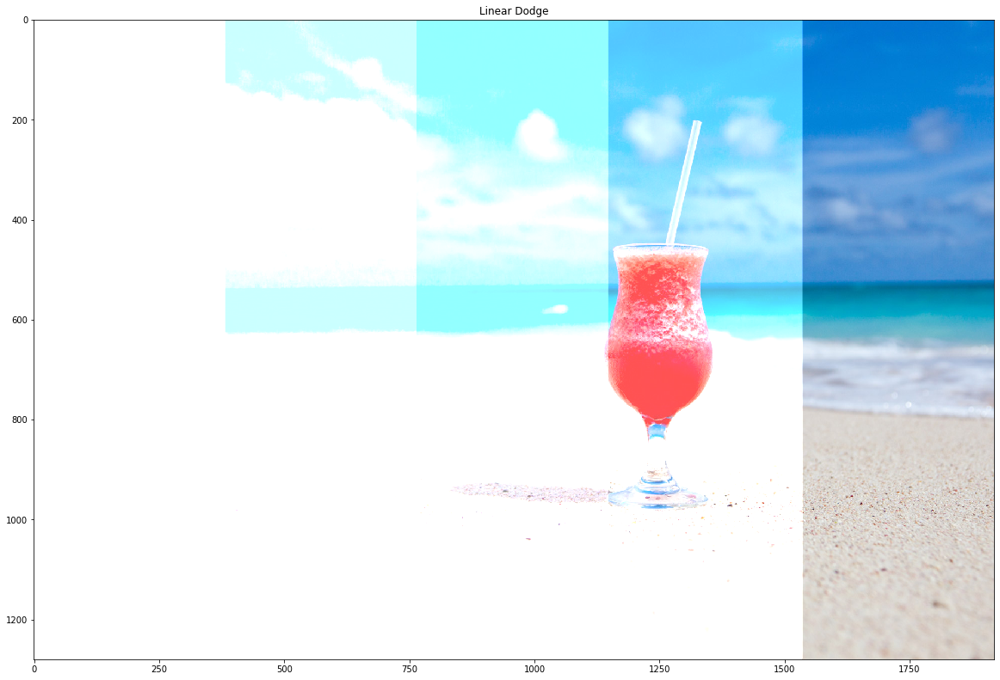

In [20]:
# Linear Dodge

linear_dodge = np.clip(foreground + background, 0, 1.)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(linear_dodge)
plt.title('Linear Dodge')
plt.show()

## Overlay

В этом режиме цвета умножаются или осветляются в зависимости от основного цвета. Узоры или цвета перекрывают существующие пикселы, оставляя неизменными светлые и темные участки основного цвета. Базовый цвет не заменяется, а смешивается с совмещенным цветом, что позволяет отразить наличие светлых или темных участков первоначального цвета.

Наложение сочетает в себе режимы Multiply и Screen blend. Части верхнего слоя, где базовый слой светлый, становятся светлее, части, где базовый слой темнее, становятся темнее. Области, где верхний слой имеет средне-серый цвет, не затрагиваются.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/ueberlagern.gif)

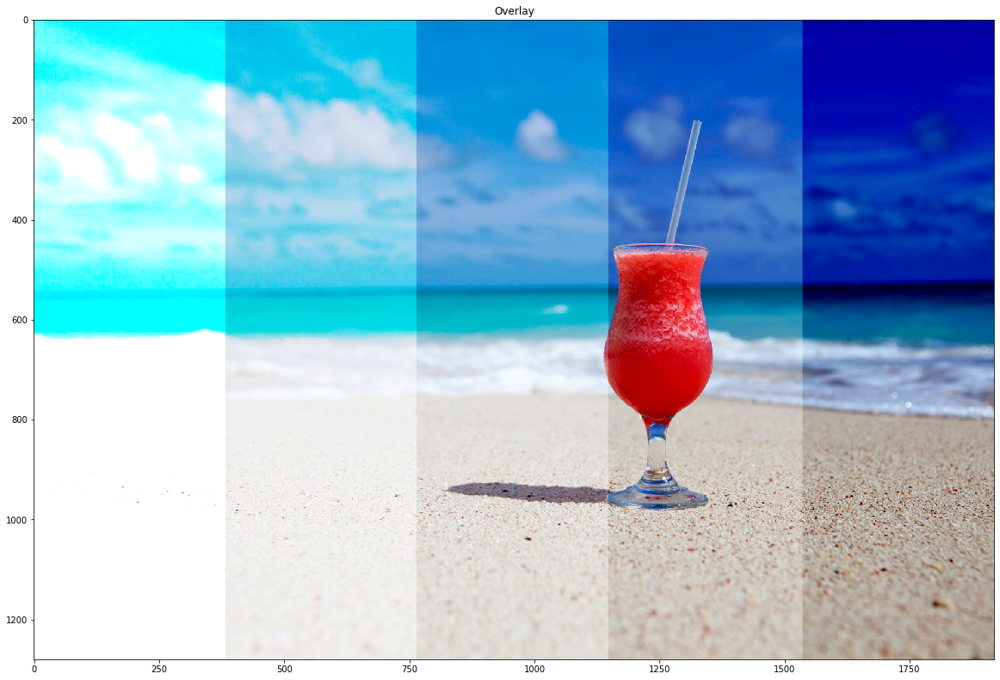

In [21]:
# Overlay

mask = background >= 0.5 
overlay = np.zeros_like(background) 

# now do the blending 
overlay[~mask] = (2 * background * foreground)[~mask] 
overlay[mask] = (1 - 2 * (1 - background) * (1 - foreground))[mask]  

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(overlay)
plt.title('Overlay')
plt.show()


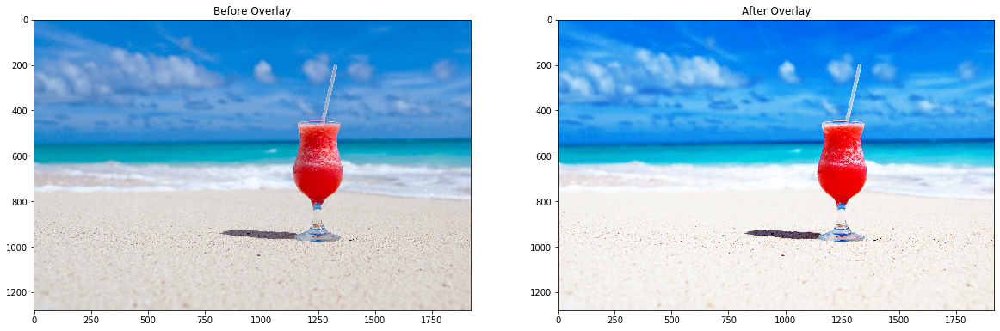

In [22]:
# Overlay 2

mask = background >= 0.5 
overlay = np.zeros_like(background) 

# now do the blending 
overlay[~mask] = (2 * background * background)[~mask] 
overlay[mask] = (1 - 2 * (1 - background) * (1 - background))[mask]  

fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(20, 20))
axs[0].set_title('Before Overlay')
axs[0].imshow(background)
axs[1].set_title('After Overlay')
axs[1].imshow(overlay)
plt.show()

## Soft Light

В этом режиме цвета становятся более темными или более светлыми в зависимости от совмещенного цвета. Полученный эффект аналогичен освещению изображения рассеяным светом прожектора. Если совмещенный цвет (источник света) является более светлым, чем 50 % серого, то изображение становится светлее, как после осветления. Если совмещенный цвет является более темным, чем 50 % серого, изображение становится темнее, как после затемнения. Раскрашивание чистым черным или белым цветом создает отчетливые, более темные или более светлые зоны, но чистого черного или белого цвета не получится.

Этот режим осветляет и затемняет цвета изображения в зависимости от цвета верхнего слоя. Это почти то же самое, что фильтр рассеянный свет. Хорошо подойдет для корректировки тонов, повышения контраста на изображениях с небольшой контрастностью, а понижение прозрачности даст еще более изысканный эффект.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/weiches_licht.gif)

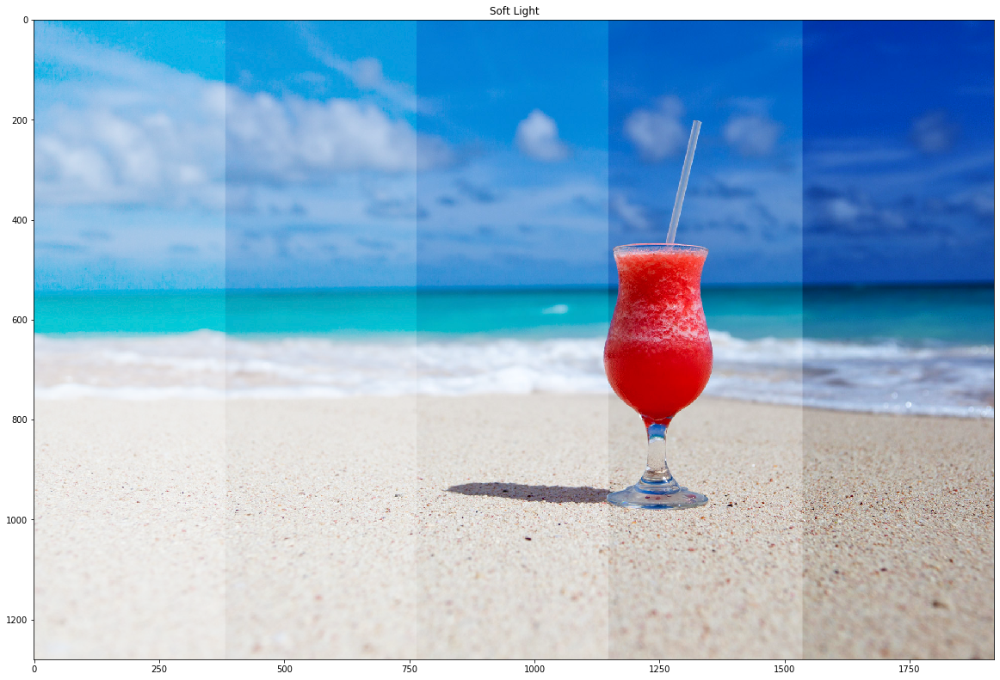

In [23]:
# Soft Light

mask = foreground >= 0.5 
soft_light = np.zeros_like(foreground) 

# now do the blending 
soft_light[~mask] = ((2 * foreground - 1) * (background - background * background) + background)[~mask]
soft_light[mask] = ((2 * foreground - 1) * (np.sqrt(background) - background) + background)[mask]  

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(soft_light)
plt.title('Soft Light')
plt.show()

## Hard Light

В этом режиме цвета умножаются или осветляются в зависимости от совмещенного цвета. Полученный эффект аналогичен освещению изображения резким светом прожектора. Если совмещенный цвет (источник света) является более светлым, чем 50 % серого, то изображение становится светлее, как после осветления. Этот эффект может применяться для добавления светлых участков к изображению. Если совмещенный цвет (источник света) является более темным, чем 50 % серого, то изображение становится темнее, как после умножения. Этот эффект может применяться для добавления темных участков к изображению. Рисование чисто-черным или чисто-белым цветом приводит к получению чисто-черного или чисто-белого цвета.

Hard Light также является комбинацией Multiply и Screen. Жесткий свет влияет на отношение слоя наложения к базовому слою таким же образом, как наложение влияет на отношение базового слоя к слою наложения. Обратная зависимость между Overlay и Hard Light делает их «переключающими режимами наложения»

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/hartes_licht.gif)

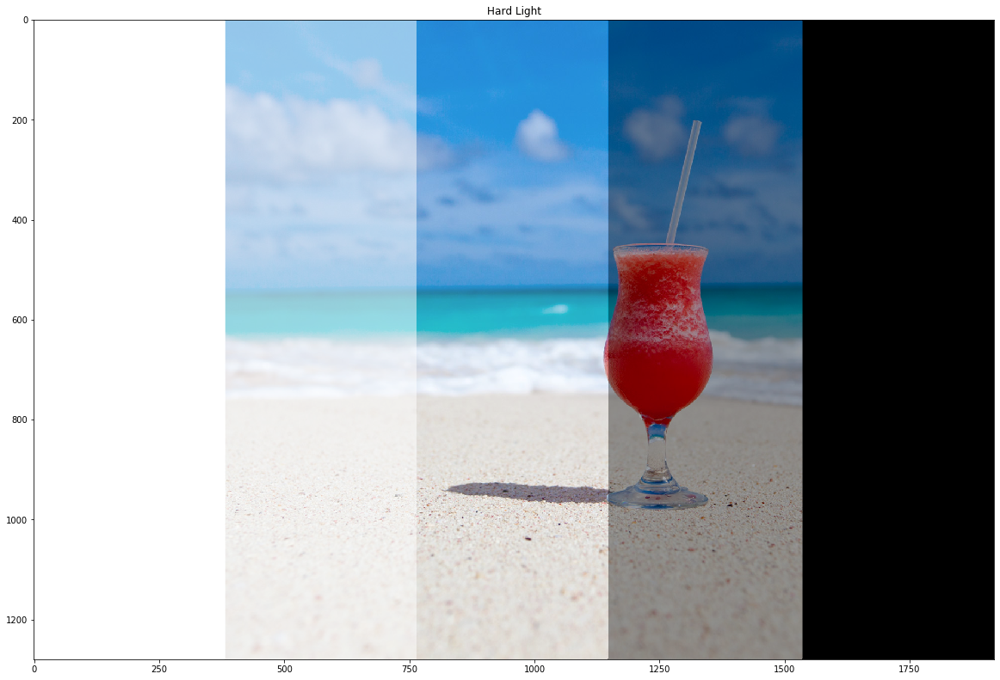

In [24]:
# Hard Light

mask = foreground >= 0.5 
hard_light = np.zeros_like(foreground) 

# now do the blending 
hard_light[~mask] = (2 * background * foreground)[~mask] 
hard_light[mask] = (1 - 2 * (1 - background) * (1 - foreground))[mask] 

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(hard_light)
plt.title('Hard Light')
plt.show()

## Vivid Light

Применение этого режима приводит к затемнению или осветлению цвета в результате увеличения или уменьшения контраста в зависимости от совмещенного цвета. Если совмещенный цвет (источник света) является более светлым, чем 50 % серого, то изображение становится светлее в результате уменьшения контраста. Если совмещенный цвет (источник света) является более темным, чем 50 % серого, то изображение становится темнее в результате увеличения контраста.

Этот режим смешивания очень сильно увеличивает контраст, особенно в светлых и темных местах. Вы можете представить его эффект как комбинацию Color Burn (в тени) и Color Dodge (в бликах). Две формулы для A <0,5 и A> 0,5 идентичны соответствующим формулам этих режимов смешивания (кроме удвоений в знаменателях).

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/strahlen_licht.gif)

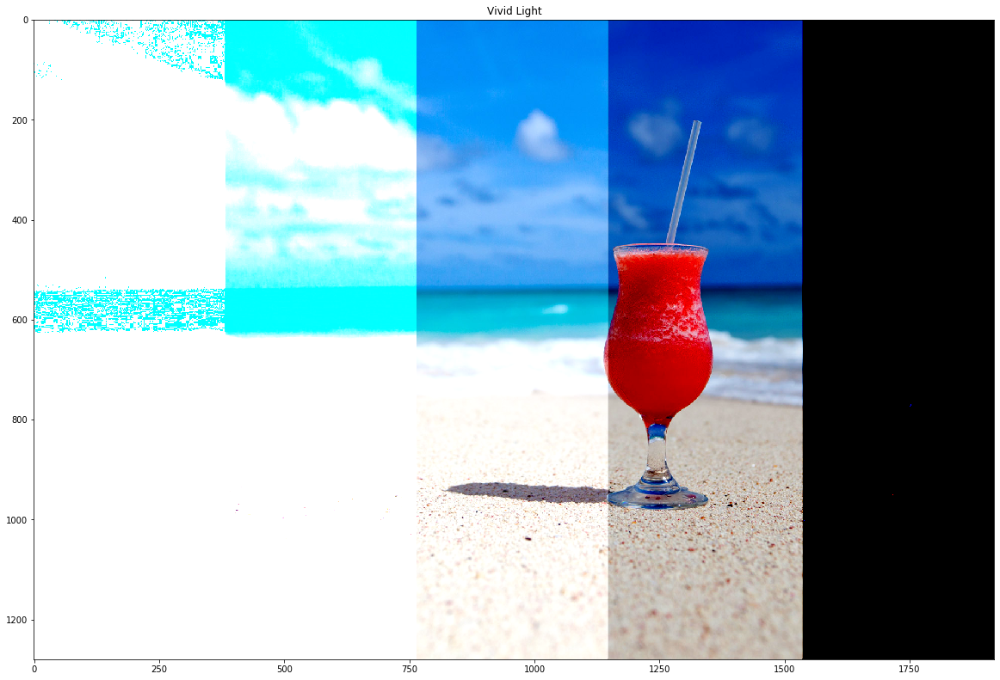

In [25]:
# Vivid Light

mask = foreground >= 0.5 
vivid_light = np.zeros_like(foreground) 

# now do the blending 
vivid_light[~mask] = (1.0 - (1.0 - background) / (2.0 * foreground + div_error))[~mask] 
vivid_light[mask] = (background / (2.0 * (1.0 - foreground) + div_error))[mask]  

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(np.clip(vivid_light, 0., 1.))
plt.title('Vivid Light')
plt.show()

## Linear Light

Применение этого режима приводит к затемнению или осветлению цвета в результате увеличения или уменьшения яркости в зависимости от совмещенного цвета. Если совмещенный цвет (источник света) является более светлым, чем 50 % серого, то изображение становится светлее в результате увеличения яркости. Если совмещенный цвет (источник света) является более темным, чем 50 % серого, то изображение становится темнее в результате уменьшения яркости.

Этот режим  увеличивает контраст немного меньше, чем предыдущий. Это напоминает Linear Burn, но с удвоенным влиянием на тональные значения переднего плана.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/lineares_licht.gif)

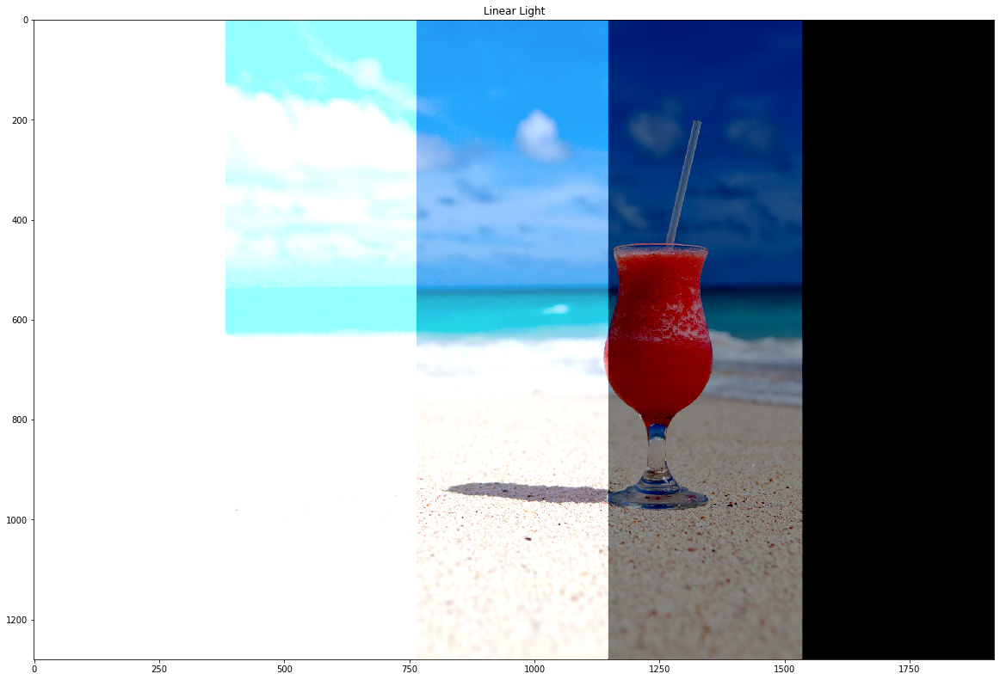

In [26]:
# Linear Light

linear_Light = np.clip(background + 2.0 * foreground - 1., 0, 1.)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(linear_Light)
plt.title('Linear Light')
plt.show()

## Pin Light

Применение этого режима приводит к замене цвета в зависимости от совмещенного цвета. Если совмещенный цвет (источник света) является более светлым, чем 50 % серого, то пикселы с цветом, более темным по сравнению с совмещенным, заменяются, а пикселы с цветом, более светлым по сравнению с совмещенным, остаются неизменными. Если совмещенный цвет (источник света) является более темным, чем 50 % серого, то пикселы с цветом, более светлым по сравнению с совмещенным, заменяются, а пикселы с цветом, более темным по сравнению с совмещенным, остаются неизменными. Этот режим может применяться для добавления специальных эффектов к изображению.

В этом режиме смешанное изображение создается в соответствии с одним из трех условий: отдельно от фонового изображения (C = B), от изображения переднего плана, яркость которого была удвоена (C = 2A), или от последнего, но яркость уменьшилась на 1, то есть 256 тональных значений (C = 2A - 1). Какое условие выбрано, зависит от пропорции тональных значений переднего и заднего фона. Визуально, результат является комбинацией режимов Darken и Lighten. Области среднего тона остаются практически без влияния.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/lichtpunkte.gif)

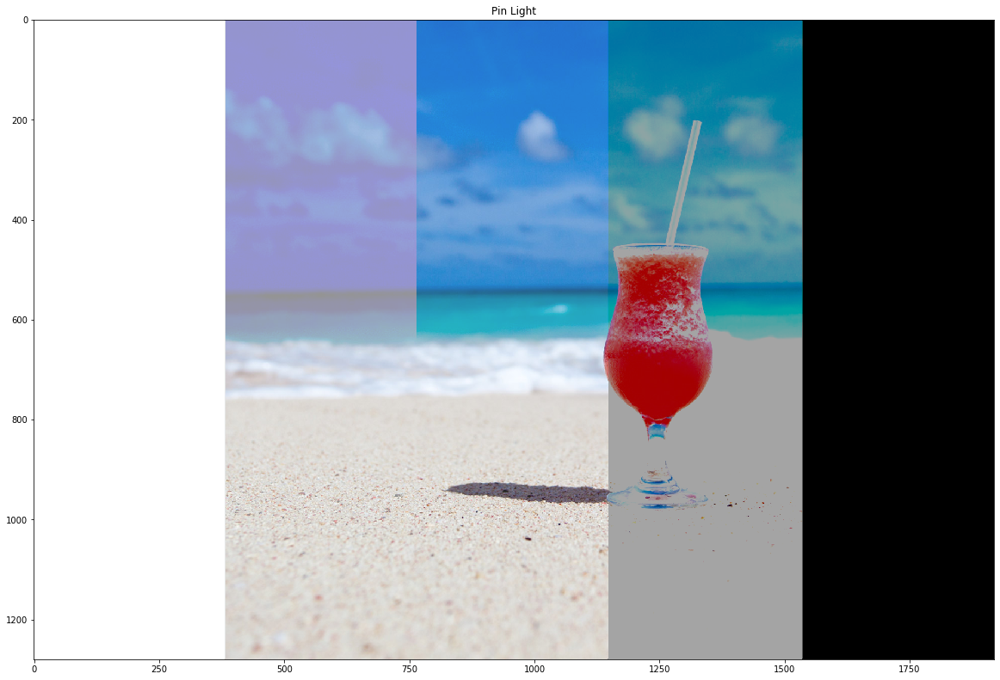

In [27]:
# Pin Light

mask = background < (2. * foreground - 1.)
mask2 = background > 2. * foreground

pin_light = np.copy(background)

# now do the blending 
pin_light[mask] = (2. * foreground - 1)[mask] 
pin_light[mask2] = (2. * foreground)[mask2]

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(pin_light)
plt.title('Pin Light')
plt.show()

## Hard Mix

Добавляет значения красного, зеленого и синего каналов совмещенного цвета к значениям RGB основного цвета. Если результирующая сумма для какого-либо канала равна 255 или больше, каналу присваивается значение 255; в противном случае — 0. Поэтому для всех пикселов смешанного цвета значения красного, зеленого и голубого каналов будут равняться 0 или 255. Все пикселы заменяются на основные аддитивные цвета (красный, зеленый или синий), белый или черный.

Результирующее изображение этого режима смешивания содержит только шесть основных цветов, черный и белый. В соответствии с пропорциональностью тональных значений передних и фоновых пикселей смешанные тональные значения устанавливаются для каждого канала равными 0 или 1 (т.е. 255).

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/harte_mischung.gif)

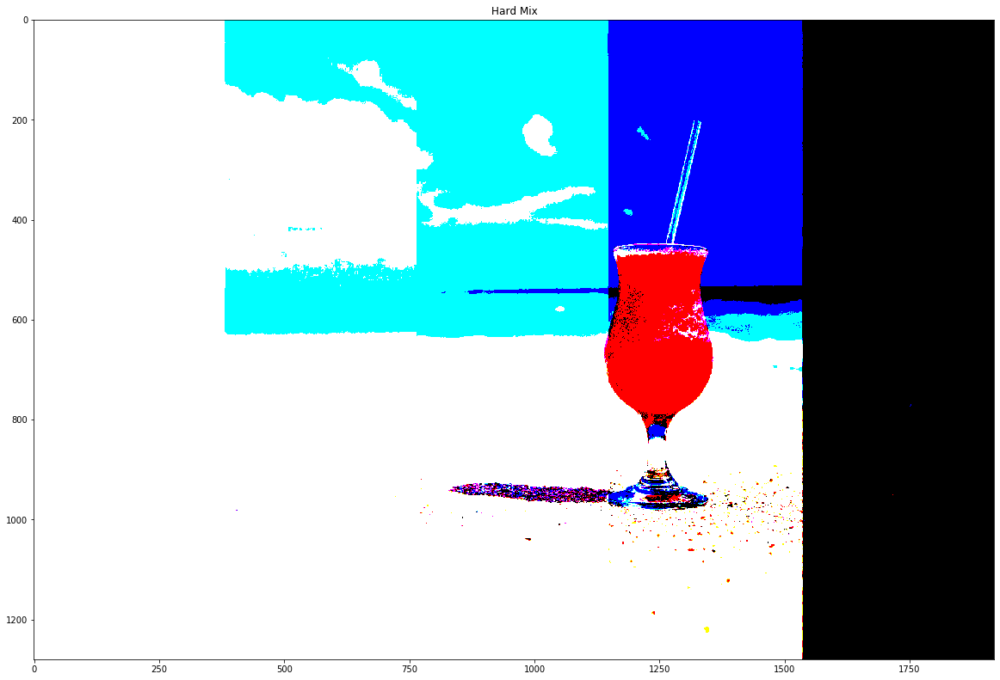

In [28]:
# Hard Mix

mask = foreground >= 1 - background 
hard_mix = np.zeros_like(foreground) 

# now do the blending 
hard_mix[~mask] = (foreground * 0)[~mask] 
hard_mix[mask] = (foreground * 0 + 1.0)[mask] 

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(np.clip(hard_mix, 0., 1.))
plt.title('Hard Mix')
plt.show()

## Difference

Difference вычитает нижний слой из верхнего или наоборот, чтобы всегда получать положительное значение. Смешивание с черным не дает никаких изменений, так как значения для всех цветов равны 0. (Значение RGB для черного - (0,0,0).) Смешивание с белым инвертирует изображение.

Одной из основной областью применения для этого является процесс редактирования, когда его можно использовать для проверки выравнивания изображений с похожим содержанием.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/differenz.gif)

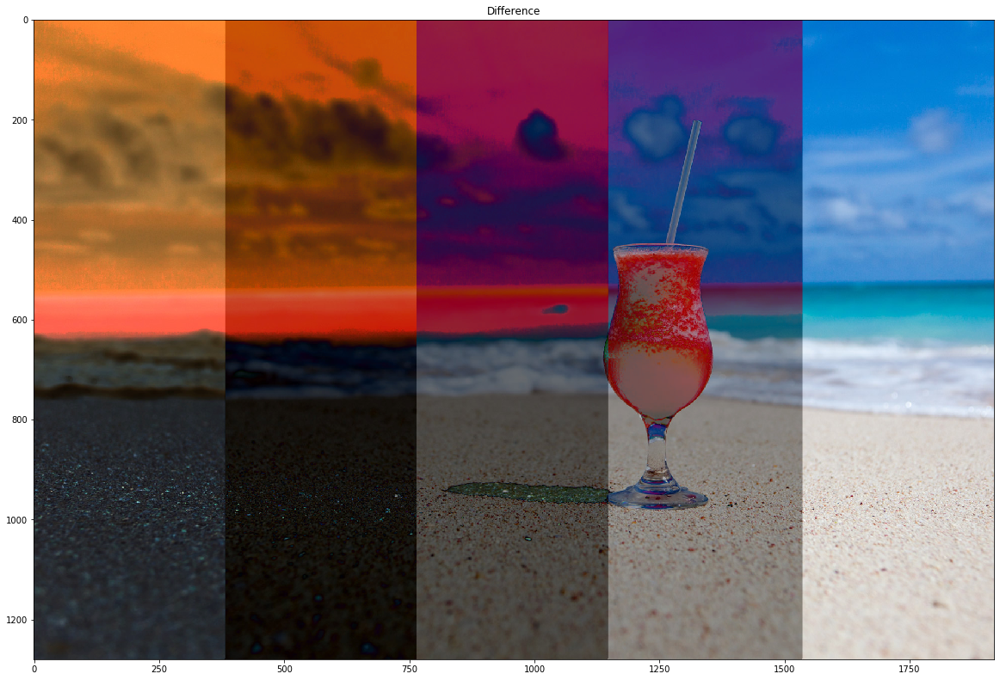

In [29]:
# Difference

difference = abs(foreground - background)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(difference)
plt.title('Difference')
plt.show()

## Exclusion

Яркие области изображения вызывают инверсию к соответствующему другому слою, очень темные области вообще ничего не меняют. Таким образом, этот режим напоминает предыдущий. Однако, в отличие от предыдущего, средние значения серого значительно снижают контрастность соответствующего другого изображения, в крайних случаях до нуля. Этот режим также симметричен, то есть он работает независимо от того, какое изображение является верхним.

Этот режим симметричен: замена двух слоев не меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/ausschluss.gif)

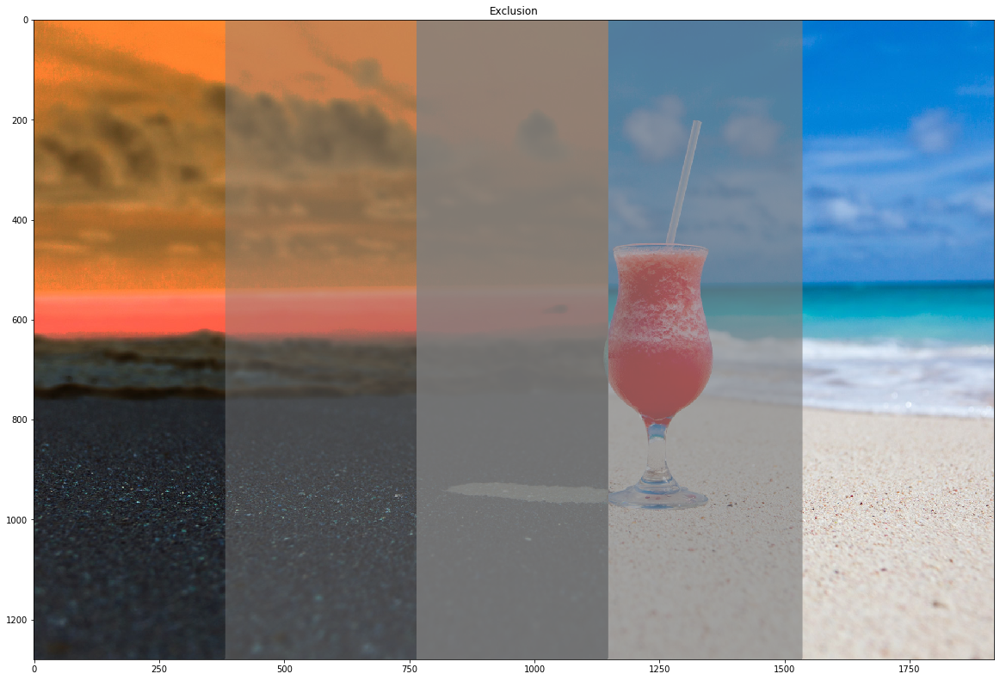

In [30]:
# Exclusion

exclusion = foreground + background - 2.0 * foreground * background

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(exclusion)
plt.title('Exclusion')
plt.show()


## Subtract

Этот режим наложения просто вычитает значения пикселей одного слоя с другим. В случае отрицательных значений отображается черный цвет.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/subtraktion.gif)

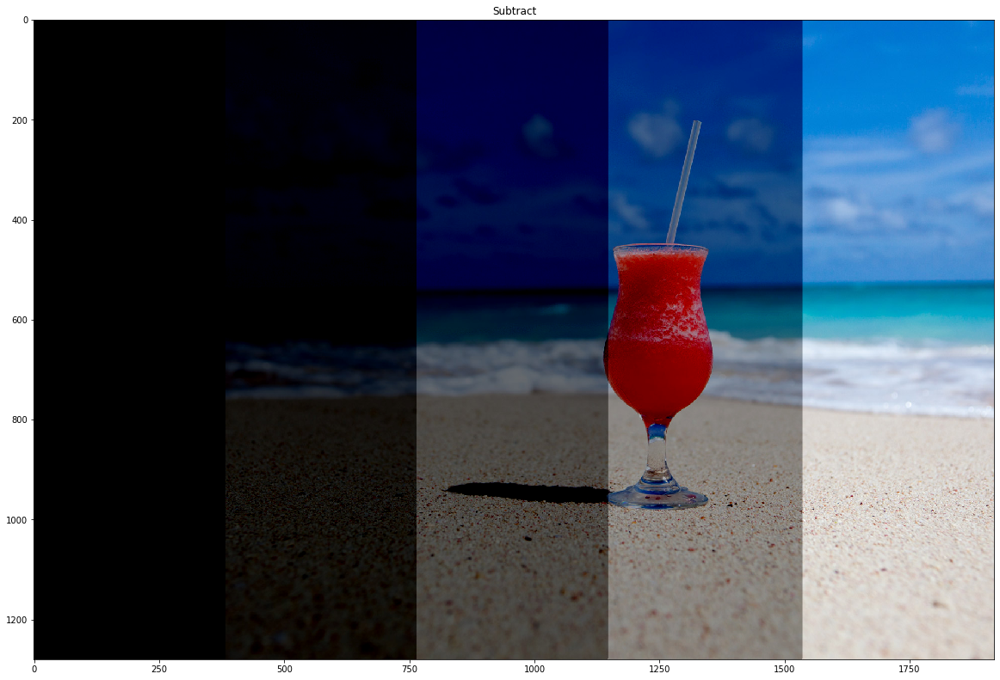

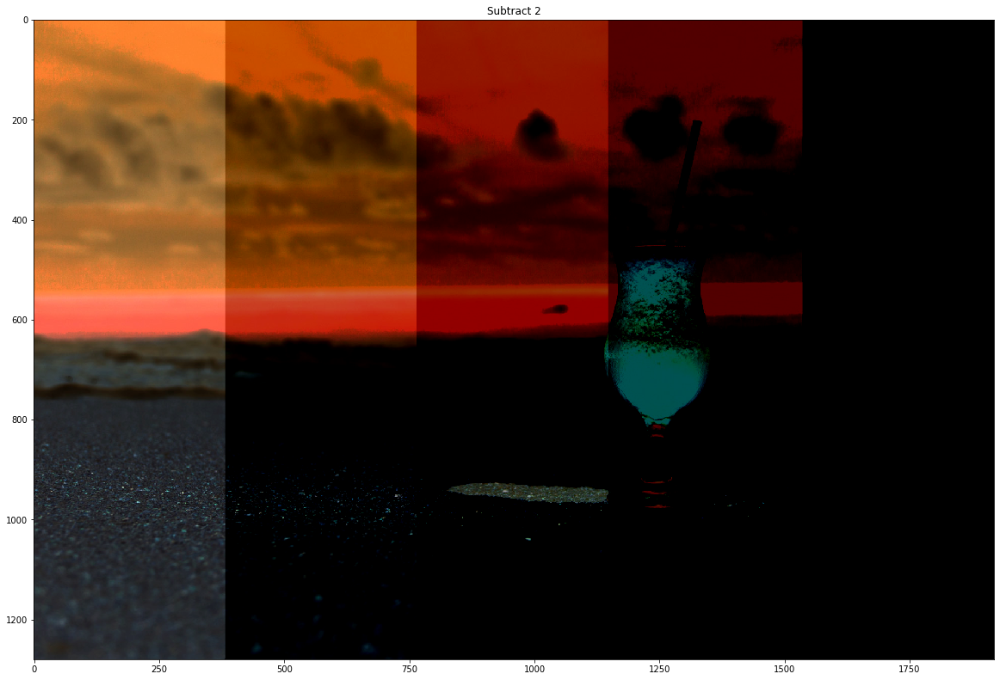

In [31]:
# Subtract

subtract = background - foreground

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(np.clip(subtract, 0, 1.))
plt.title('Subtract')
plt.show()

subtract2 = foreground - background

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(np.clip(subtract2, 0, 1.))
plt.title('Subtract 2')
plt.show()

## Divide

Этот режим смешивания просто делит значения пикселей одного слоя с другим, это полезно для осветления фотографий, если цвет серый или меньше. Это также полезно для удаления цветного оттенка с фотографии. Если вы создаете слой, который соответствует цвету оттенка, который вы хотите удалить - например, бледно-голубой, для сцен, которые слишком холодные по цветовой температуре - в режиме деления этот цвет будет возвращаться к белому в результирующей композиции, так как любое значение будет разделено само по себе равно 1,0 (белый).

Этот режим асимметричен: замена двух слоев меняет результат.

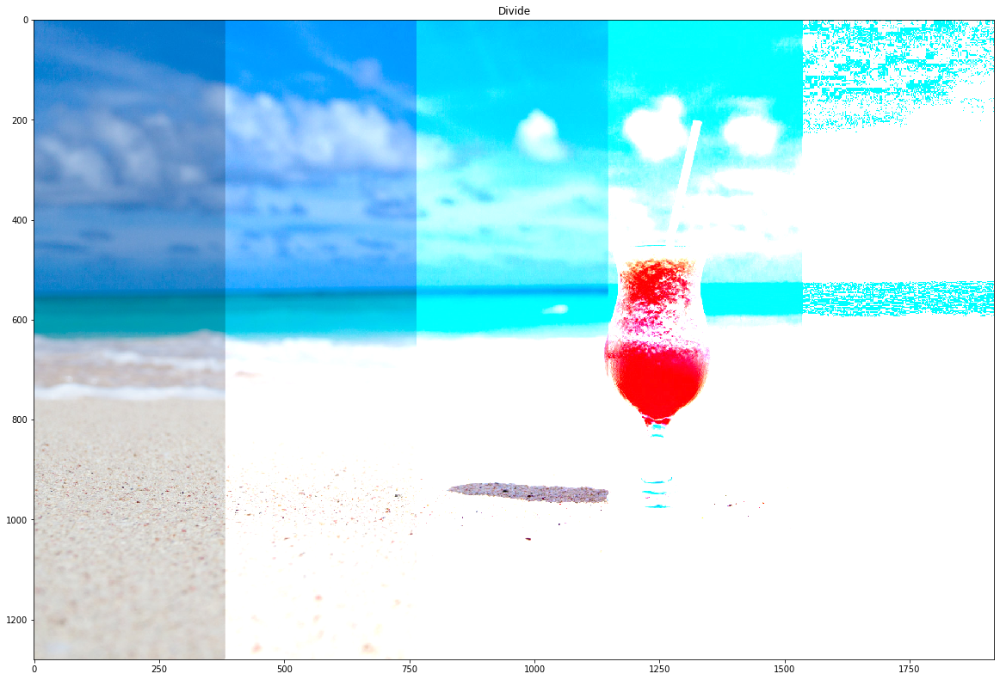

In [32]:
# Divide

divide = background / (foreground + div_error)

fig, ax = plt.subplots(figsize=(20, 20))

plt.imshow(np.clip(divide, 0, 1.))
plt.title('Divide')
plt.show()

## Hue

В этом режиме создается результирующий цвет со светимостью и насыщенностью основного цвета и цветовым тоном совмещенного цвета.

Режим наложения Hue сохраняет яркость и цветность нижнего слоя, в то же время принимая оттенок верхнего слоя.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/farbton.gif)

## Saturation

В этом режиме создается результирующий цвет со светимостью и цветовым тоном основного цвета и насыщенностью совмещенного цвета. Рисование в этом режиме в области, не имеющей насыщенности, а именно имеющей насыщенность, равную 0 (т. е. в области с серым цветом), не приводит к каким-либо изменениям.

Режим наложения «Saturation» сохраняет яркость и оттенок нижнего слоя, принимая цветность верхнего слоя.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/saettigung.gif)

## Color

С помощью этого параметра создается результирующий цвет со светимостью основного цвета и с цветовым тоном и насыщенностью совмещенного цвета. Этот параметр сохраняет уровни серого в изображении и может применяться для раскрашивания монохромных изображений и добавления оттенков к цветным изображениям.

Режим Color сохраняет яркость нижнего слоя, принимая оттенок и цветность верхнего слоя.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/farbe.gif)

## Luminosity

В этом режиме создается результирующий цвет с цветовым тоном и насыщенностью основного цвета и светимостью совмещенного цвета. Этот режим создает эффект инверсии цветового режима.

Режим наложения Luminosity сохраняет оттенок и цветность нижнего слоя, в то же время принимая яркость верхнего слоя.

Этот режим асимметричен: замена двух слоев меняет результат.

![Formula](http://www.simplefilter.de/grundlagen/images/helligkeit.gif)